Experimental Dataset - 2D class - class 39- 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [3]:
KEYWORD      = 'cryo_exp_class_2d_30_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_30_epoch_255_checkpoint.pth'
EPOCH_NUMBER = 255

In [4]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_30_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [5]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (4917, 1, 128, 128) metadata.shape (4917, 180, 180)


In [6]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(4917, 4)

In [7]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [8]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

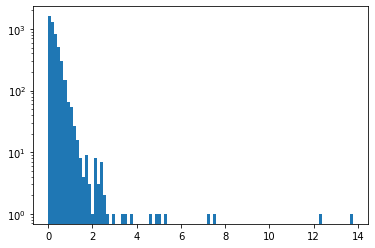

0.3076966410550946 0.4419991678740162


In [9]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

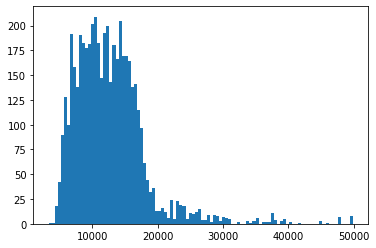

3333.739502 12692.950592391499 5603.567648669399


In [10]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

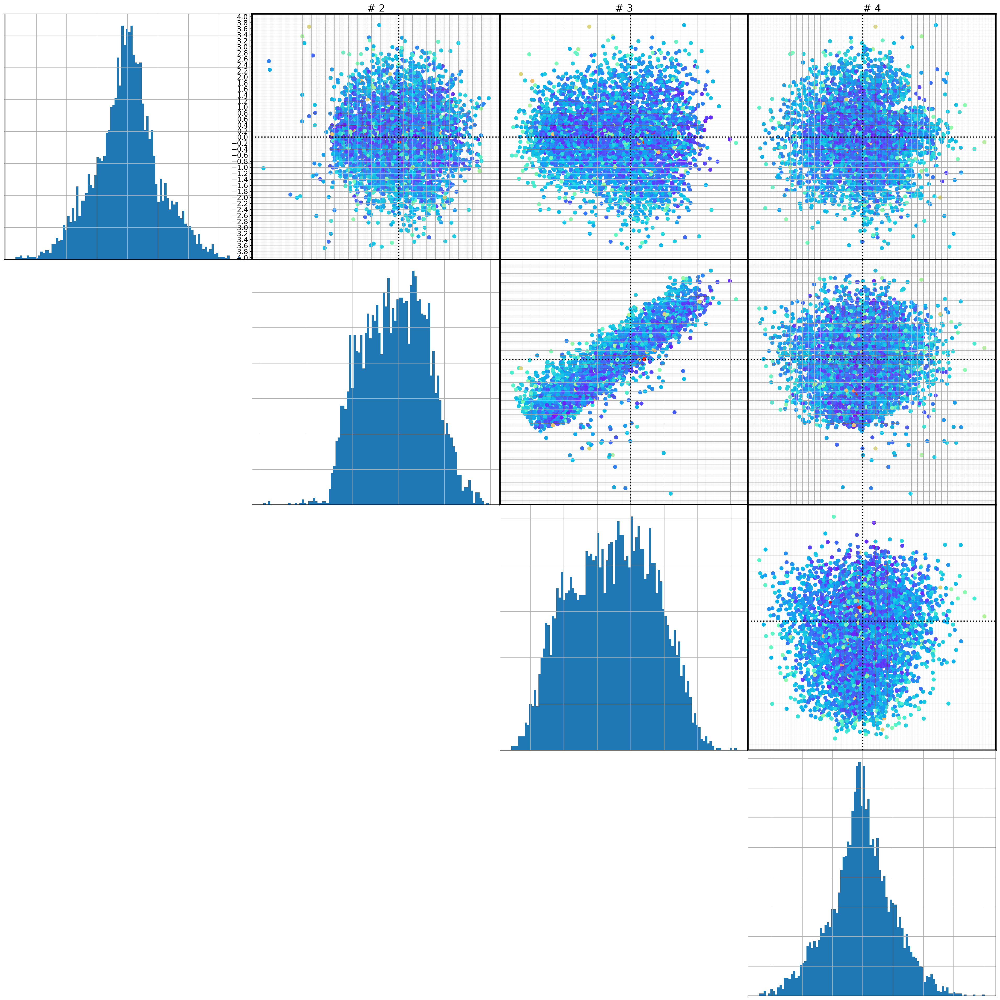

In [11]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [12]:
center = np.mean(mus,axis=0) #np.zeros(mus.shape) #
U, L, Vt = np.linalg.svd(mus - center, full_matrices=False)

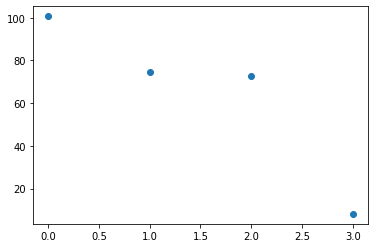

In [13]:
plt.plot(L, 'o')

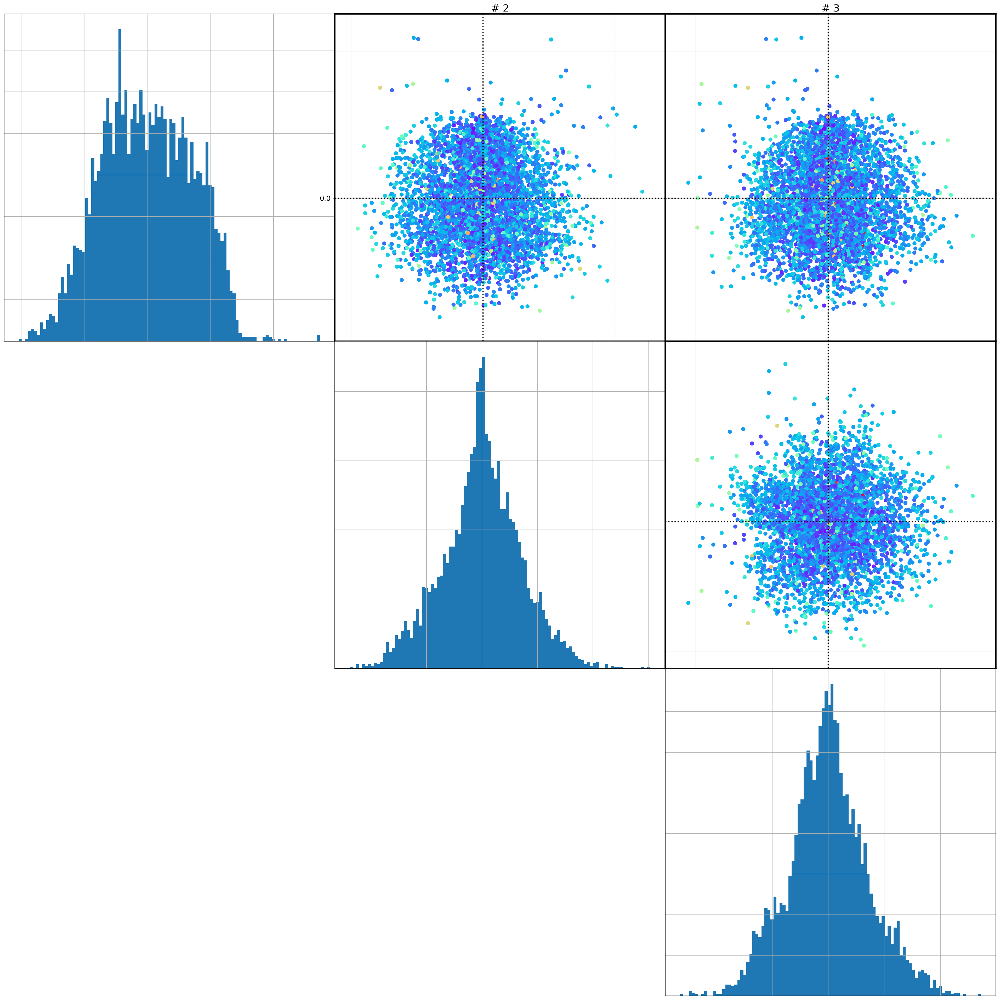

In [14]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

# Data curation

## Outlier prediction

In [15]:
Zscore_set=2

In [16]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(4883,) (34,)


AUC(robust_covar) = 0.8346363734926696
AUC(isolation_forest) = 0.8234390622929492
AUC(local_outlier_detection) = 0.8733782269819662


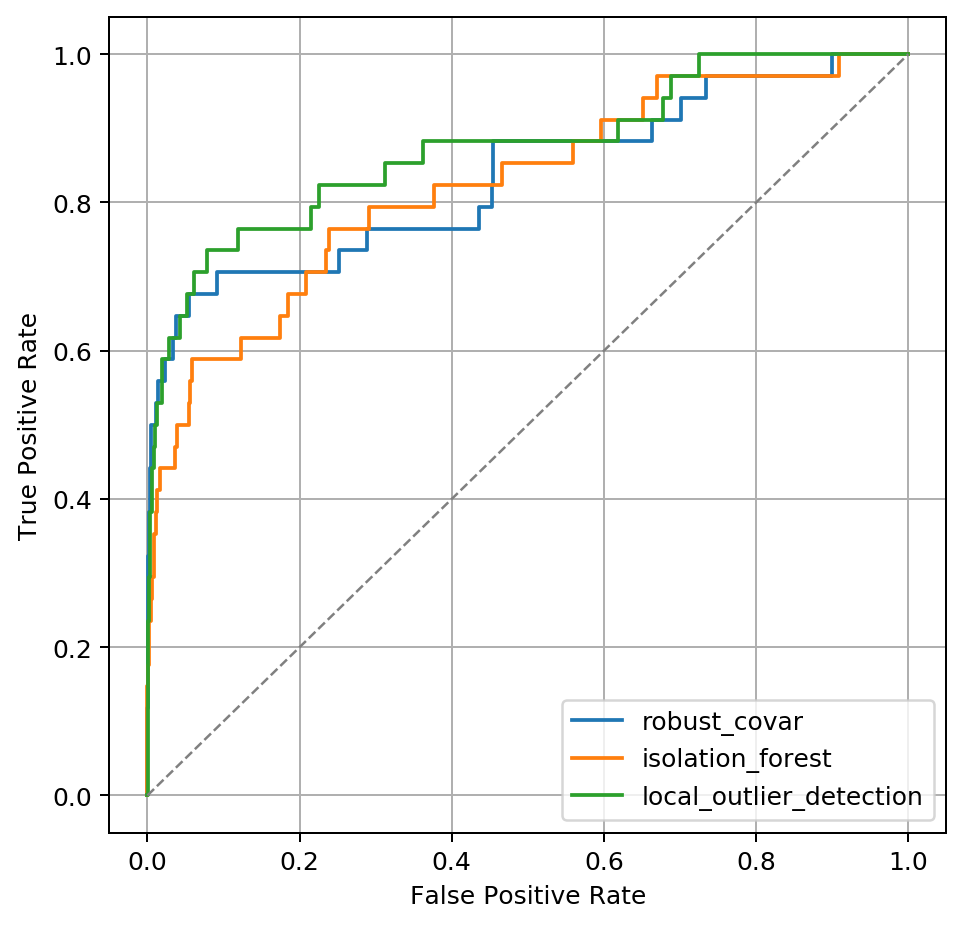

In [17]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#

In [18]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

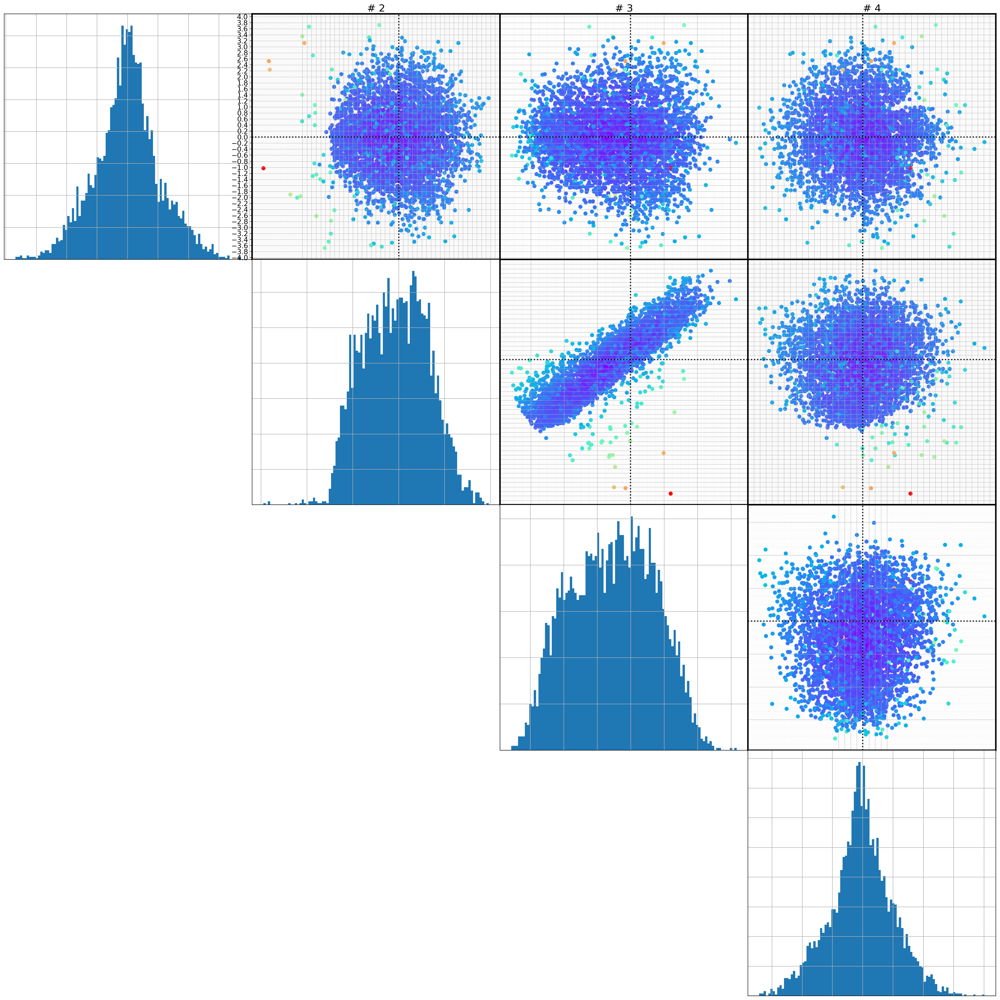

In [19]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [20]:
measure_threshold=5

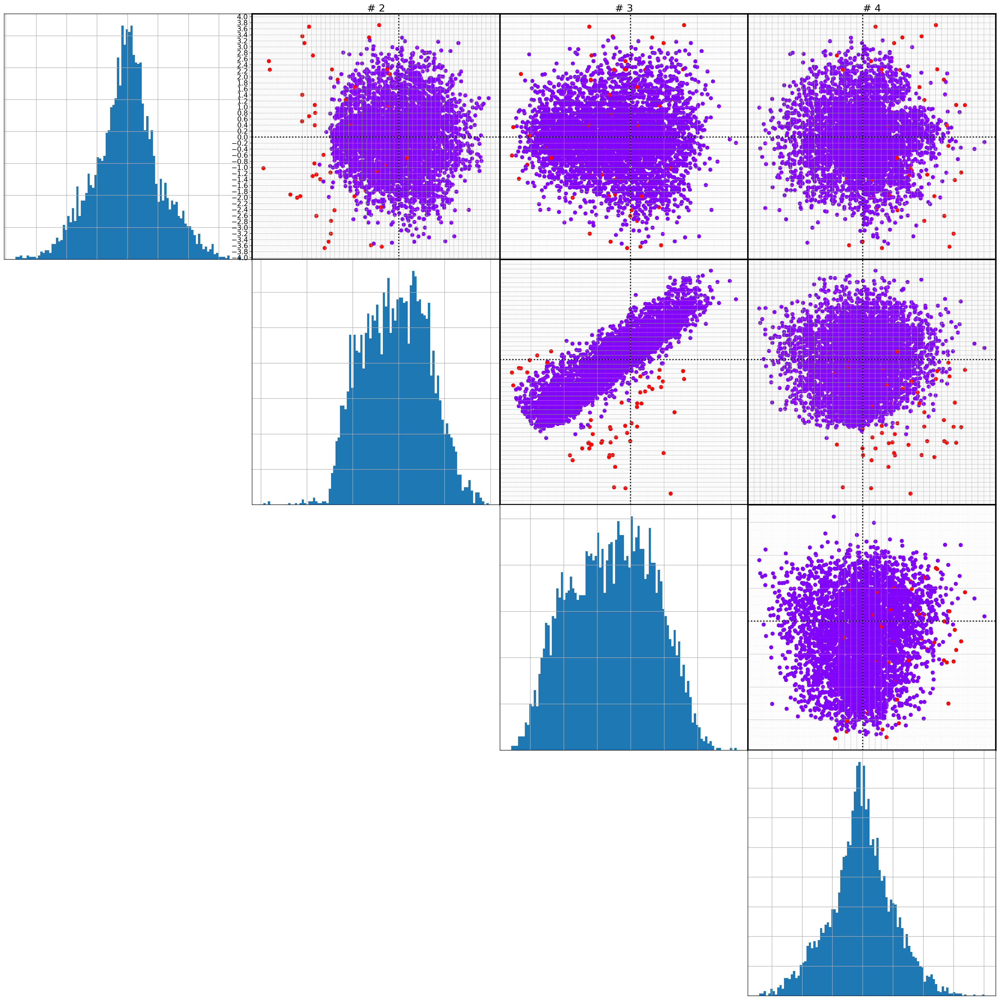

In [21]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), 
            figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [22]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(4862, 4)
(4862,)
(4862,)
(4862,)


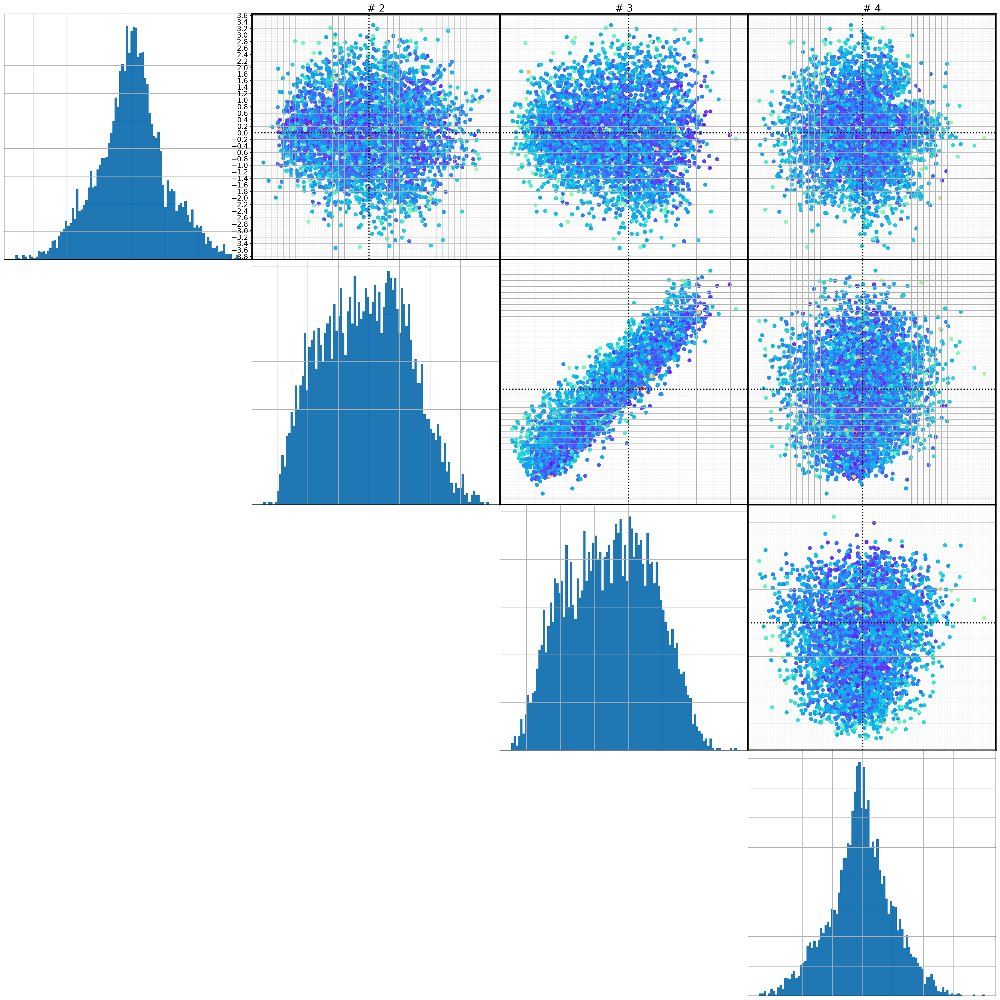

In [23]:
viz.biplots(mus_kept, n=4, show_histo=True, nbins=100, c=defocus_kept)

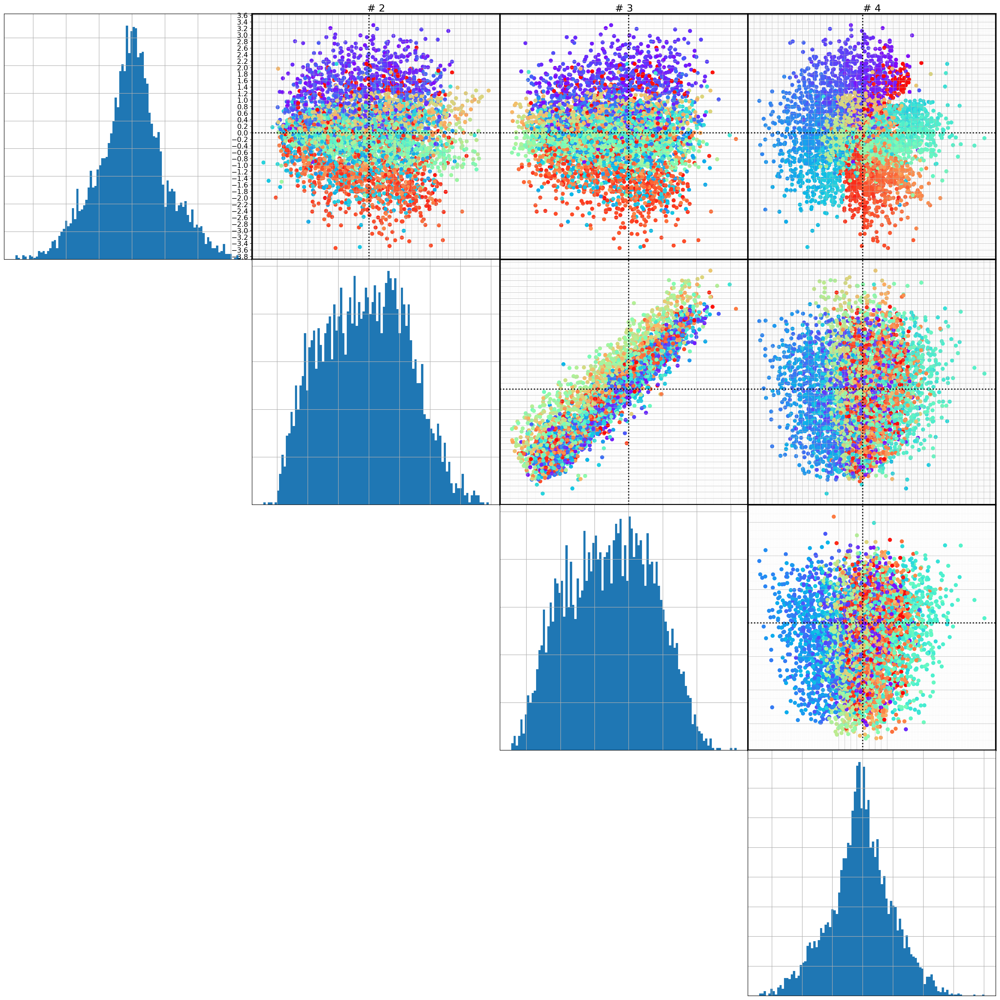

In [24]:
viz.biplots(mus_kept, n=4, show_histo=True, nbins=100, c=angle_kept)

## Remove user-defined outliers

In our case, knowledge of metadata helps getting rid of "bad" data (i.e. defocus values out of reasonable range)

In [25]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]
mus_curated     = mus_kept[index,:]
angle_curated   = angle_kept[index]
defocus_curated = defocus_kept[index]
Zscore_curated  = Zscore_kept[index]

# Project in PCA space

In [26]:
center_curated = np.mean(mus_curated,axis=0) #np.zeros(mus.shape) #
U_curated, L_curated, Vt_curated = np.linalg.svd(mus_curated - center_curated, full_matrices=False)

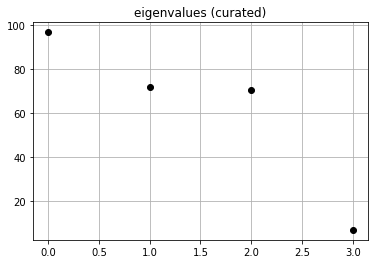

In [27]:
plt.plot(L_curated, 'ko')
plt.title('eigenvalues (curated)')
plt.grid()
plt.show()

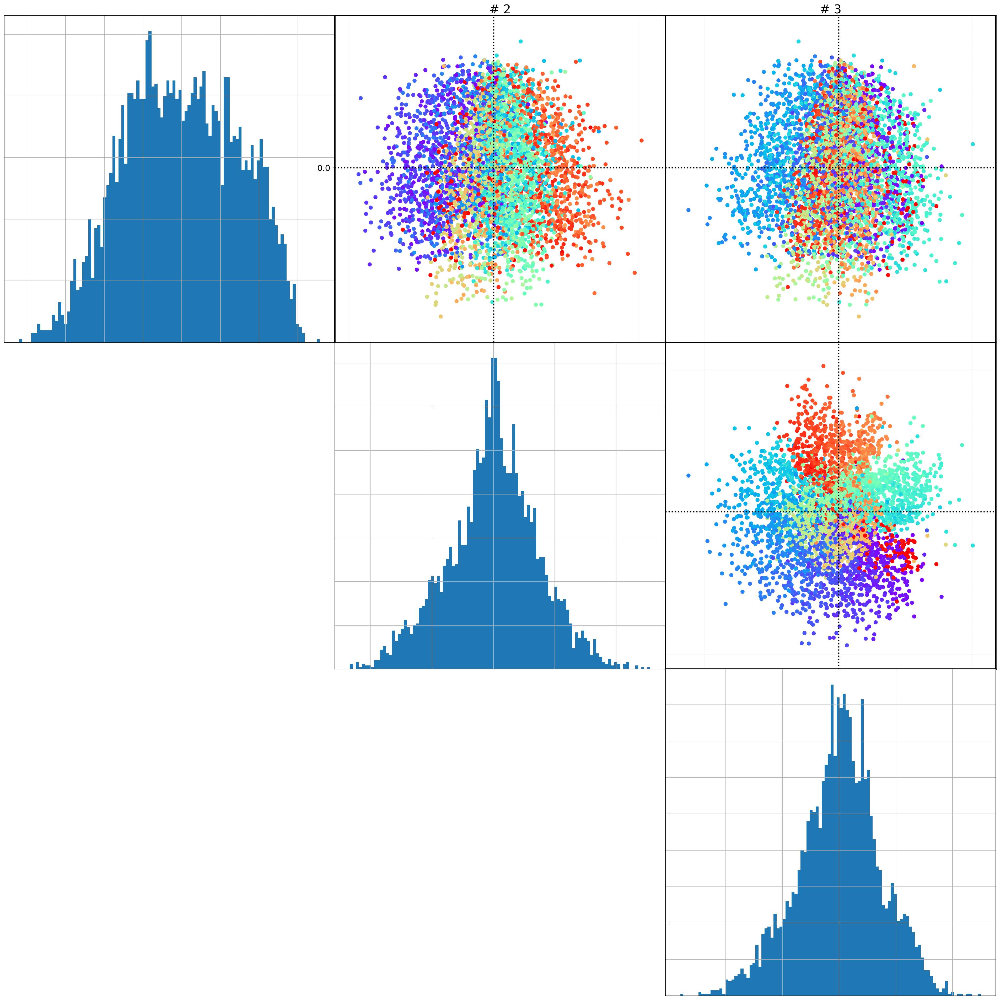

In [58]:
viz.biplots(U_curated, n=3, show_histo=True, nbins=100, c=angle_curated)

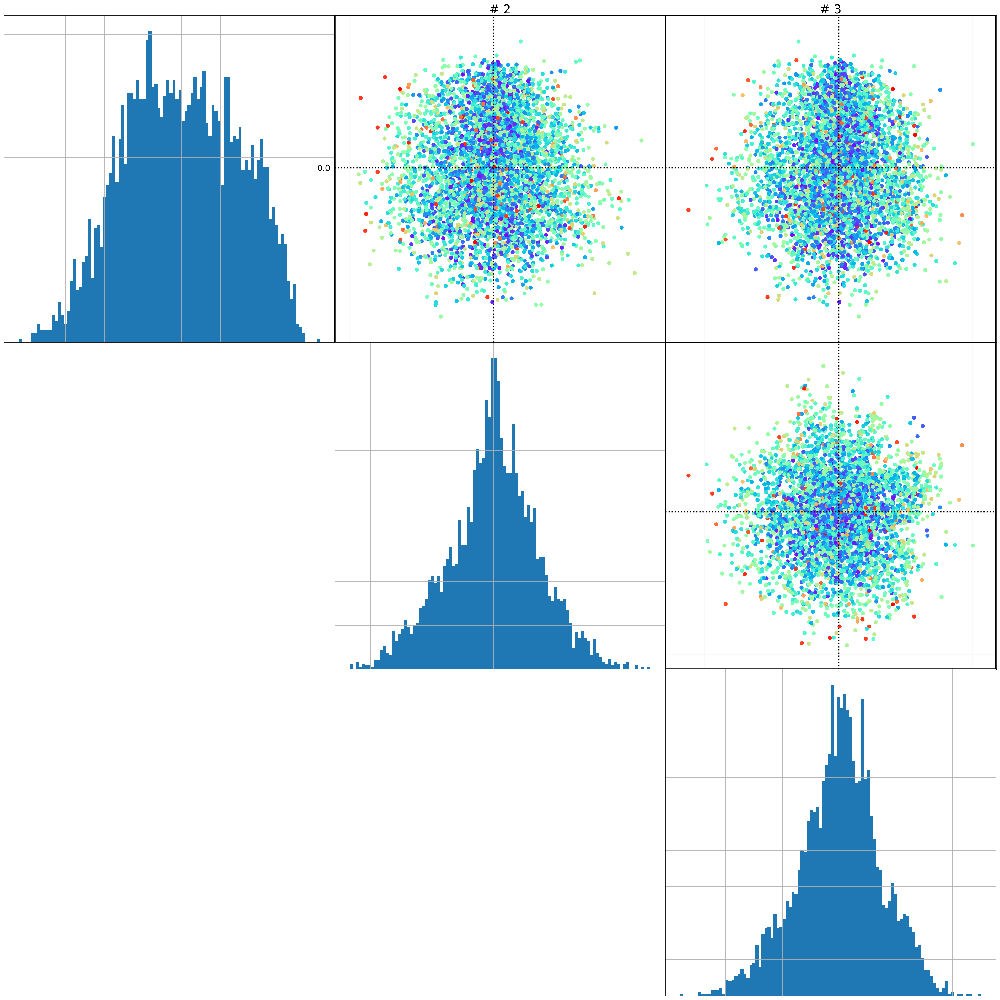

In [59]:
viz.biplots(U_curated, n=3, show_histo=True, nbins=100, c=defocus_curated)

# Parameter prediction

## Simple ellipse fitting

In [60]:
angle_true   = angle_curated + 180
defocus_true = defocus_curated

## stable portion

In [61]:
angle_pred, defocus_pred = pred.pred2d(U_curated, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [62]:
defocus_pred

array([12273.127 , 12212.107 , 14362.609 , ...,  7968.0107, 10672.195 ,
       12654.225 ], dtype=float32)

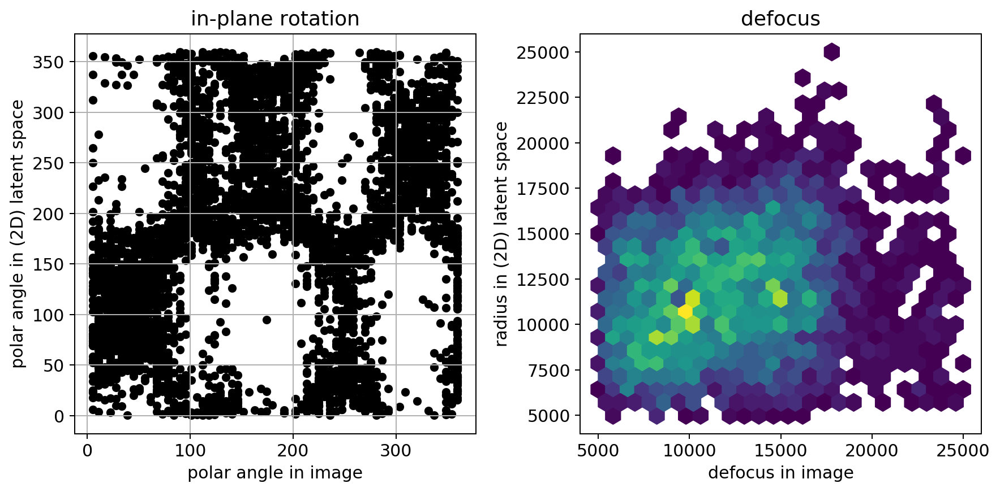

In [63]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

offset: -300 angle RMSE = 112.6490630670867
offset: -280 angle RMSE = 115.1492822408691
offset: -260 angle RMSE = 116.11898740657742
offset: -240 angle RMSE = 115.34194931674115
offset: -220 angle RMSE = 112.9234366410412
offset: -200 angle RMSE = 109.61554379952176
offset: -180 angle RMSE = 105.99519829147341
offset: -160 angle RMSE = 102.52498846876298
offset: -140 angle RMSE = 99.25784533015985
offset: -120 angle RMSE = 96.4487549527636
offset: -100 angle RMSE = 94.3281828757763
offset: -80 angle RMSE = 92.86305485625775
offset: -60 angle RMSE = 91.86301577747696
offset: -40 angle RMSE = 92.18726340378433
offset: -20 angle RMSE = 94.6036407459253
offset: 0 angle RMSE = 99.01142292605829
offset: 20 angle RMSE = 104.30421962704263
offset: 40 angle RMSE = 109.09419591076907
offset: 60 angle RMSE = 112.64906304336316
offset: 80 angle RMSE = 115.14928227549106
offset: 100 angle RMSE = 116.11898741973386
offset: 120 angle RMSE = 115.34194932326986
offset: 140 angle RMSE = 112.923436686249

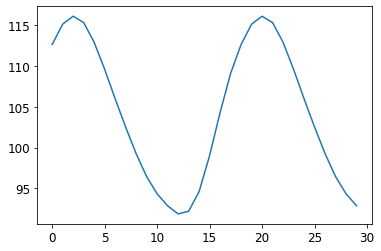

In [37]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-300,300,20))
plt.plot(angle_RMSE_list)

### weight angle RMSE with defocus pred

In [64]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

offset: -48.0 angle RMSE = 88.33104158002561
offset: -47.75 angle RMSE = 88.32797037513703
offset: -47.5 angle RMSE = 88.3251732682778
offset: -47.25 angle RMSE = 88.32245021526472
offset: -47.0 angle RMSE = 88.3203356394594
offset: -46.75 angle RMSE = 88.31889704532762
offset: -46.5 angle RMSE = 88.31790303683404
offset: -46.25 angle RMSE = 88.31735678429753
offset: -46.0 angle RMSE = 88.31698399754103
offset: -45.75 angle RMSE = 88.31692154644827
offset: -45.5 angle RMSE = 88.31718765496491
offset: -45.25 angle RMSE = 88.31748119362071
offset: -45.0 angle RMSE = 88.31788528690817
offset: -44.75 angle RMSE = 88.31835284940234
offset: -44.5 angle RMSE = 88.31941740451464
offset: -44.25 angle RMSE = 88.32068459057825
defocus RMSE = 4732.543191972561


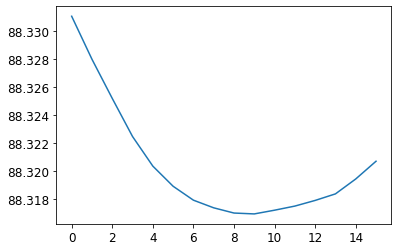

In [67]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-48,-44,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -31.0 angle RMSE = 93.08649055095717
offset: -30.75 angle RMSE = 93.11749349647087
offset: -30.5 angle RMSE = 93.14915709602765
offset: -30.25 angle RMSE = 93.18102490754376
offset: -30.0 angle RMSE = 93.21313912178374
offset: -29.75 angle RMSE = 93.24562912342469
offset: -29.5 angle RMSE = 93.2784808843804
offset: -29.25 angle RMSE = 93.31149193912945
offset: -29.0 angle RMSE = 93.34464350407474
offset: -28.75 angle RMSE = 93.37793246787159
offset: -28.5 angle RMSE = 93.41135413966903
offset: -28.25 angle RMSE = 93.44503026888108
offset: -28.0 angle RMSE = 93.47875558031983
offset: -27.75 angle RMSE = 93.51288698470071
offset: -27.5 angle RMSE = 93.5476740432667
offset: -27.25 angle RMSE = 93.58311603207072
defocus RMSE = 4732.543191972561


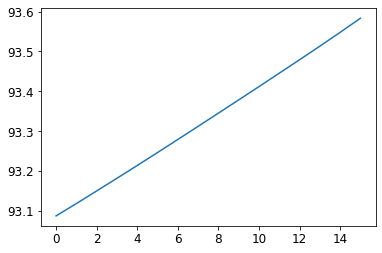

In [40]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-31,-27,0.25),
                                                angle_weight=np.exp(-np.abs(Zscore[index])), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -54.0 angle RMSE = 88.49846871299297
offset: -53.75 angle RMSE = 88.48657417370133
offset: -53.5 angle RMSE = 88.47519848972868
offset: -53.25 angle RMSE = 88.46447432897708
offset: -53.0 angle RMSE = 88.45430712760596
offset: -52.75 angle RMSE = 88.44454710638617
offset: -52.5 angle RMSE = 88.43549273912794
offset: -52.25 angle RMSE = 88.427047306852
defocus RMSE = 4732.543191972561


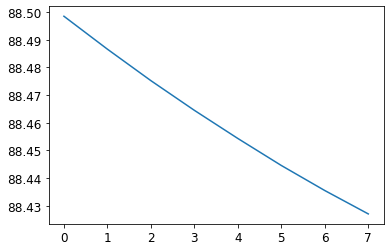

In [41]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-54,-52,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

## Cone fitting (ad-hoc)

In [42]:
from scipy.stats import special_ortho_group
from scipy.optimize import curve_fit

def f(x, A, B): # this is your 'straight line' y=f(x)
    return A*x + B

nsample=1000 #10000
ax = np.empty((nsample,3))
ay = np.empty((nsample,3))
az = np.empty((nsample,3))
ax[0,...] = [1,0,0]
ay[0,...] = [0,1,0]
az[0,...] = [0,0,1]
score_list = []

rotmat = np.diag([1,1,1])
U_rotated = np.dot(rotmat,U_curated[:,0:3].T).T
popt, pcov = curve_fit(f, U_rotated[:,2], np.linalg.norm(U_rotated[:,0:2],axis=1))
score = np.abs(popt[0])#np.sum((f(U_curated[:,0], *popt) - np.linalg.norm(U_rotated[:,1:3],axis=1))**2)
#center, axis, theta_0, score= pred.fitEllipse(U_curated)
score_min = score
rotmat_min = rotmat
center_min = center
ibest = 0
score_list.append(score)
print(ibest,score_min)
#rotmat_min = special_ortho_group.rvs(3)
for i in np.arange(1,nsample):
    rotmat = special_ortho_group.rvs(3)
    ax[i,...] = np.dot(rotmat,ax[0,...])
    ay[i,...] = np.dot(rotmat,ay[0,...])
    az[i,...] = np.dot(rotmat,az[0,...])
    U_rotated = np.dot(rotmat,U_curated[:,0:3].T).T
    popt, pcov = curve_fit(f, U_rotated[:,2], np.linalg.norm(U_rotated[:,0:2],axis=1))
    score = np.abs(popt[0]) #np.sum((f(U_curated[:,0], *popt) - np.linalg.norm(U_rotated[:,1:3],axis=1))**2)
    #center, axis, theta_0, score= pred.fitEllipse(U_curated)
    if(score > score_min):
        score_min = score
        ibest = i
        rotmat_min = rotmat
        center_min = center
        print(i,score_min)
    score_list.append(score)

0 0.012038030113395671
1 0.021044899732080458
2 0.13779796335277172
31 0.14692059379749753
36 0.15936191679160783
58 0.15972519186366885
234 0.1598546302699643
369 0.16198440159370717
883 0.1621122520431697


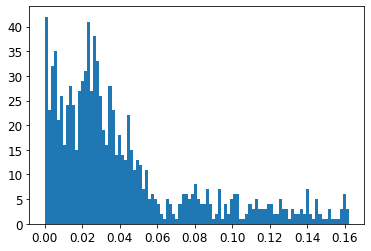

In [43]:
plt.hist(score_list, bins=np.int(nsample/10))
plt.show()

In [44]:
U_best = np.dot(rotmat_min,U_curated[:,0:3].T).T#(np.dot(rotmat_min,U_curated[:,0:3].T).T)
print(U_best.shape, U_curated.shape)

(4660, 3) (4660, 4)


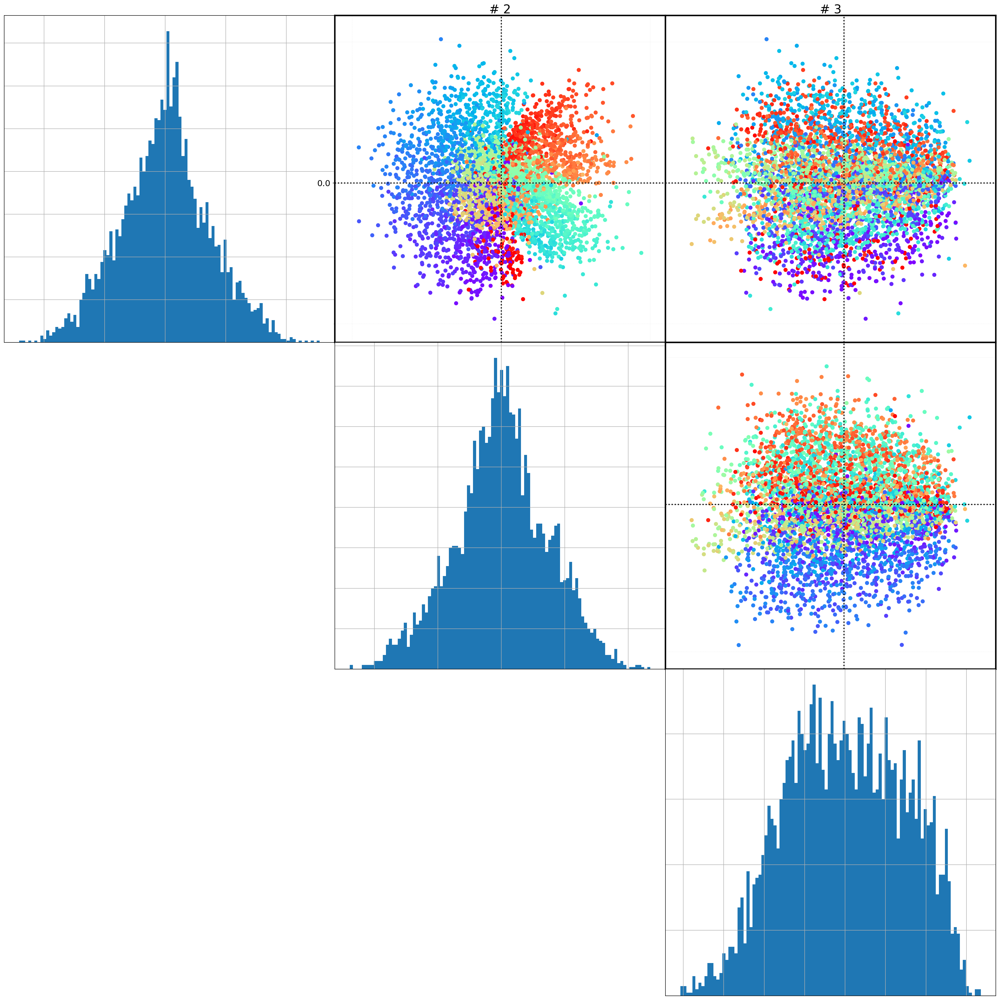

In [45]:
viz.biplots(U_best, n=3, show_histo=True, nbins=100, c=angle_true)

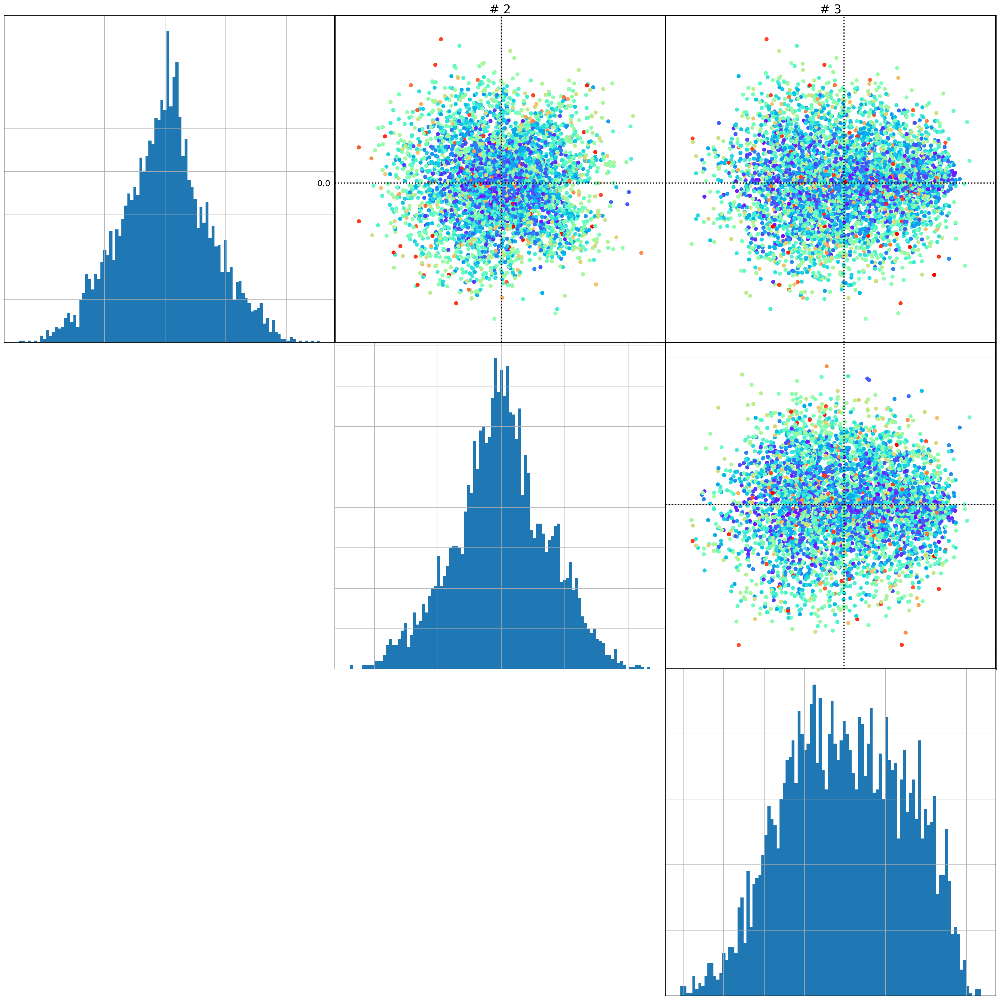

In [49]:
viz.biplots(U_best, n=3, show_histo=True, nbins=100, c=defocus_true)

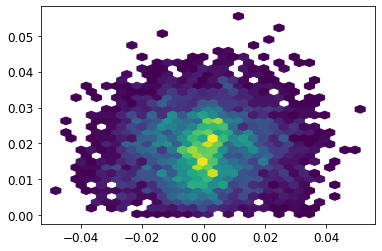

In [46]:
plt.hexbin(U_best[:,0],np.linalg.norm(U_best[:,1:3],axis=1), mincnt=1, gridsize=30)

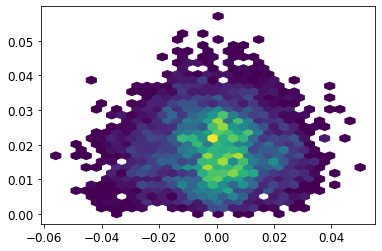

In [47]:
plt.hexbin(U_curated[:,2],np.linalg.norm(U_curated[:,0:2],axis=1), mincnt=1, gridsize=30)

In [52]:
angle_pred, defocus_pred = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

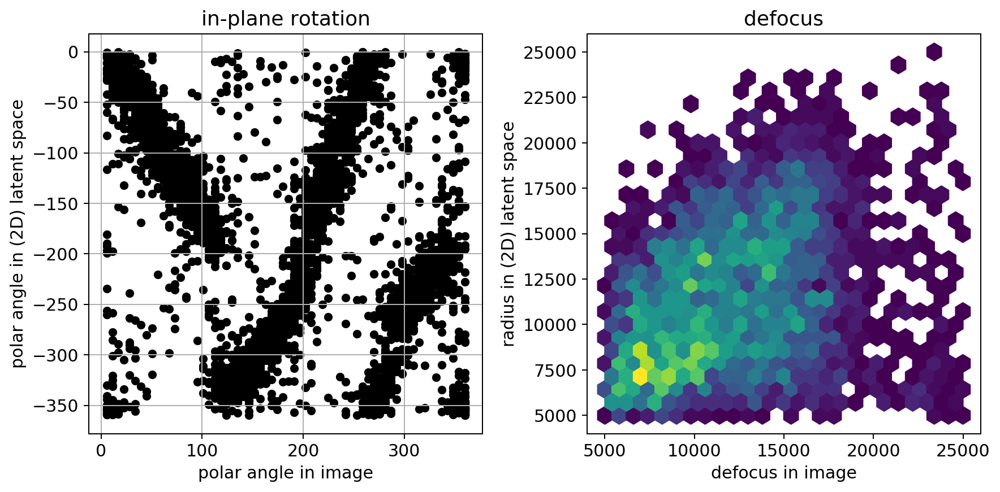

In [53]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

offset: -300 angle RMSE = 101.07623934098605
offset: -280 angle RMSE = 98.53315908691901
offset: -260 angle RMSE = 96.7242141200649
offset: -240 angle RMSE = 95.41444244852967
offset: -220 angle RMSE = 94.88838119129734
offset: -200 angle RMSE = 95.89174467927762
offset: -180 angle RMSE = 98.20011280637011
offset: -160 angle RMSE = 100.8388129899583
offset: -140 angle RMSE = 103.77680724895417
offset: -120 angle RMSE = 107.50238912570057
offset: -100 angle RMSE = 111.44434749912259
offset: -80 angle RMSE = 112.83757842803372
offset: -60 angle RMSE = 110.64510811875437
offset: -40 angle RMSE = 108.99851879540482
offset: -20 angle RMSE = 108.84968332580773
offset: 0 angle RMSE = 109.62752578542147
offset: 20 angle RMSE = 107.9745724222209
offset: 40 angle RMSE = 104.23817241559921
offset: 60 angle RMSE = 101.07623934098604
offset: 80 angle RMSE = 98.53315908691901
offset: 100 angle RMSE = 96.7242141200649
offset: 120 angle RMSE = 95.41444244852967
offset: 140 angle RMSE = 94.888381191297

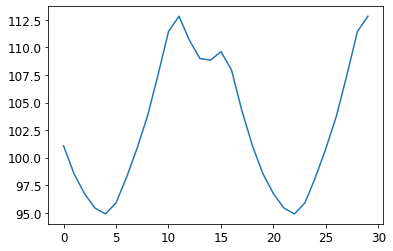

In [55]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-300,300,20))
plt.plot(angle_RMSE_list)

In [56]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

offset: -300 angle RMSE = 101.76330931693748
offset: -280 angle RMSE = 96.52691274711735
offset: -260 angle RMSE = 92.10669603419296
offset: -240 angle RMSE = 88.62263556746394
offset: -220 angle RMSE = 86.77795521063481
offset: -200 angle RMSE = 87.9049372402853
offset: -180 angle RMSE = 91.48043182707325
offset: -160 angle RMSE = 96.0093320798034
offset: -140 angle RMSE = 101.16307296674967
offset: -120 angle RMSE = 107.05304057432313
offset: -100 angle RMSE = 113.30843111023938
offset: -80 angle RMSE = 116.5551799846217
offset: -60 angle RMSE = 115.10415407694617
offset: -40 angle RMSE = 114.12557182785109
offset: -20 angle RMSE = 114.71038404505285
offset: 0 angle RMSE = 116.12233501867497
offset: 20 angle RMSE = 113.66556828582615
offset: 40 angle RMSE = 107.5844653923625
offset: 60 angle RMSE = 101.76330931693748
offset: 80 angle RMSE = 96.52691274711735
offset: 100 angle RMSE = 92.10669603419298
offset: 120 angle RMSE = 88.62263556746394
offset: 140 angle RMSE = 86.7779552106348

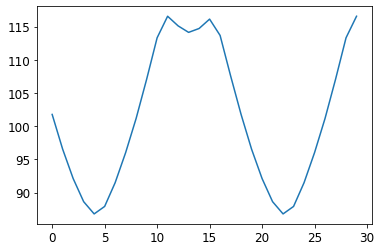

In [57]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-300,300,20),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

## Cone fitting through ellipse projective fitting (attempt)

In [80]:
from scipy.stats import special_ortho_group
nsample=10000 #10000
ax = np.empty((nsample,3))
ay = np.empty((nsample,3))
az = np.empty((nsample,3))
ax[0,...] = [1,0,0]
ay[0,...] = [0,1,0]
az[0,...] = [0,0,1]
score_list = []
center, axis, theta_0, score= pred.fitEllipse(U_curated)
score_min = score
rotmat_min = np.diag([1,1,1])
center_min = center
ibest = 0
score_list.append(score)
print(ibest,score_min)
#rotmat_min = special_ortho_group.rvs(3)
for i in np.arange(1,nsample):
    rotmat = special_ortho_group.rvs(3)
    ax[i,...] = np.dot(rotmat,ax[0,...])
    ay[i,...] = np.dot(rotmat,ay[0,...])
    az[i,...] = np.dot(rotmat,az[0,...])
    U_rotated = np.dot(rotmat,U_curated[:,0:3].T).T
    center, axis, theta_0, score= pred.fitEllipse(U_rotated)
    if(score < score_min):
        score_min = score
        ibest = i
        rotmat_min = rotmat
        center_min = center
        print(i,score_min)
    score_list.append(score)

0 0.0002145138180975931
10 0.00018308552605749014
31 0.00017618784596981927
40 0.00016927663769117073
545 0.00016639013968847762
577 0.00016548819339864
1993 0.00016544130485197835
2997 0.00016528217632152836
5248 0.00016507850770754314


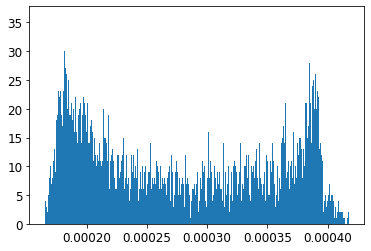

In [82]:
plt.hist(score_list, bins=np.int(nsample/10))
plt.show()

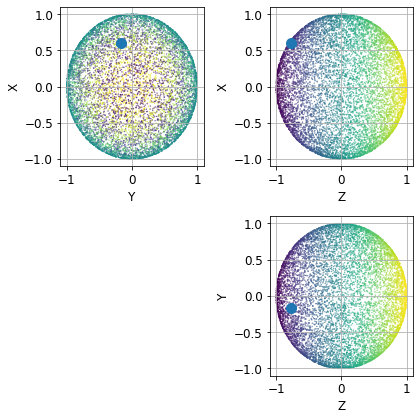

In [83]:
fig = plt.figure(figsize=(6,6))
plt.subplot(2,2,1)
plt.scatter(ax[:,1],ax[:,0],c=ax[:,2],s=0.1)
plt.scatter(ax[ibest,1],ax[ibest,0],s=100)
plt.xlabel('Y')
plt.ylabel('X')
plt.grid()
plt.subplot(2,2,2)
plt.scatter(ax[:,2],ax[:,0],c=ax[:,2],s=0.1)
plt.scatter(ax[ibest,2],ax[ibest,0],s=100)
plt.xlabel('Z')
plt.ylabel('X')
plt.grid()
plt.subplot(2,2,4)
plt.scatter(ax[:,2],ax[:,1],c=ax[:,2],s=0.1)
plt.scatter(ax[ibest,2],ax[ibest,1],s=100)
plt.xlabel('Z')
plt.ylabel('Y')
plt.grid()
plt.tight_layout()
plt.show()

In [84]:
print(rotmat_min, center_min)

[[ 0.6073048  -0.78691219  0.10931646]
 [-0.16569077  0.00911925  0.98613559]
 [-0.776999   -0.61699761 -0.12484592]] [ 0.00429805 -0.00469689]


In [85]:
U_best = np.dot(rotmat_min,U_curated[:,0:3].T).T#(np.dot(rotmat_min,U_curated[:,0:3].T).T)
print(U_best.shape, U_curated.shape)

(4798, 3) (4798, 4)


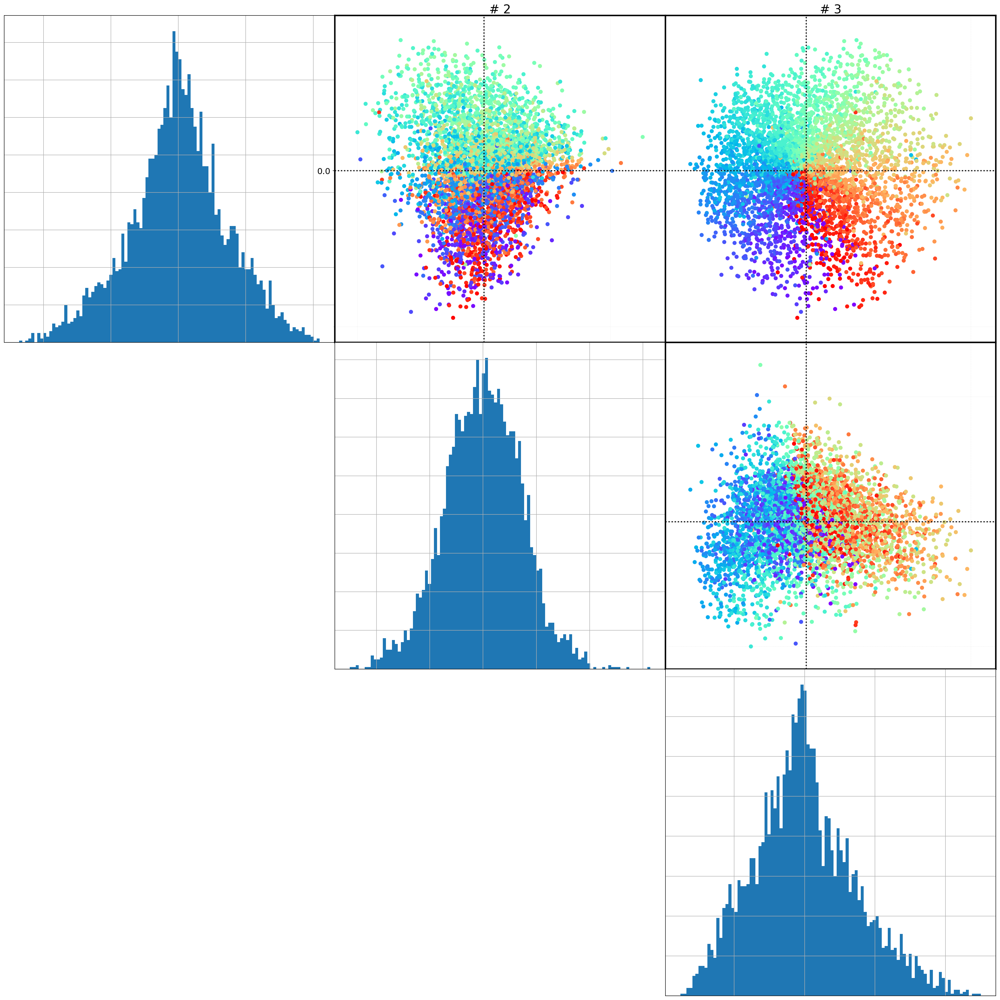

In [86]:
viz.biplots(U_best, n=3, show_histo=True, nbins=100, c=angle_true)

In [71]:
angle_best, defocus_best = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [72]:
defocus_best

array([16122.03407253,  9029.78224228,  7894.38415379, ...,
        9011.14904309, 16165.69594559,  8147.71788439])

In [73]:
print(np.linalg.norm(U_best - U_curated[:,0:3]))

2.7939598695782606


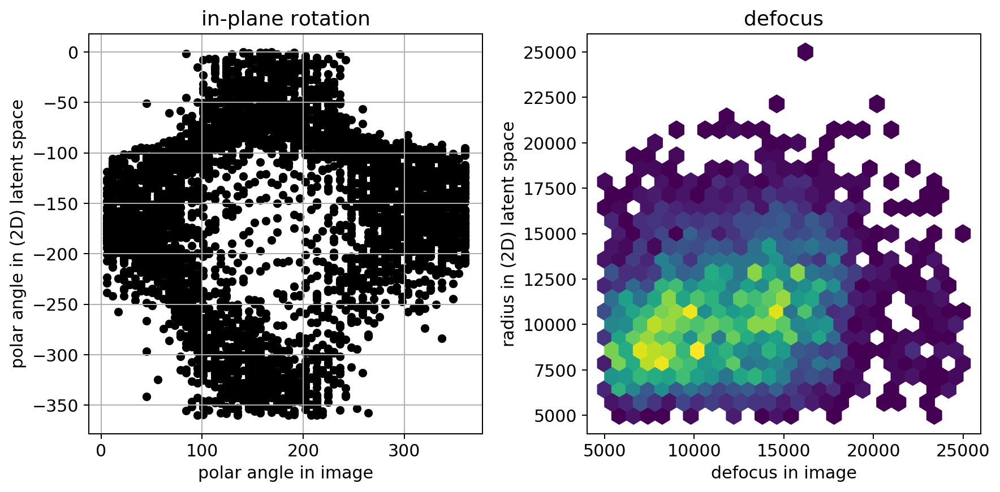

In [74]:
viz.plot_pred2d(angle_best, defocus_best, 
               angle_true, defocus_true)#, 
                #figname=KEYWORD+'/polar_prediction_ellipse_rest')

offset: -300 angle RMSE = 107.91643719893635
offset: -280 angle RMSE = 101.63281102609555
offset: -260 angle RMSE = 95.93971397724752
offset: -240 angle RMSE = 91.3470263731471
offset: -220 angle RMSE = 88.08999767308688
offset: -200 angle RMSE = 86.35385777984925
offset: -180 angle RMSE = 86.52567950101059
offset: -160 angle RMSE = 88.73778237110803
offset: -140 angle RMSE = 92.84229854344397
offset: -120 angle RMSE = 98.07967654791392
offset: -100 angle RMSE = 103.65789224329606
offset: -80 angle RMSE = 109.32268396626951
offset: -60 angle RMSE = 114.3206575890924
offset: -40 angle RMSE = 118.06572440448042
offset: -20 angle RMSE = 120.62830255378114
offset: 0 angle RMSE = 121.14435358678385
offset: 20 angle RMSE = 118.84918163590311
offset: 40 angle RMSE = 114.05856580173791
offset: 60 angle RMSE = 107.91643719893636
offset: 80 angle RMSE = 101.63281102609555
offset: 100 angle RMSE = 95.93971397724751
offset: 120 angle RMSE = 91.3470263731471
offset: 140 angle RMSE = 88.089997673086

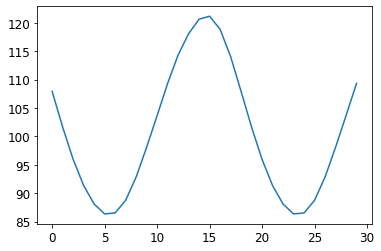

In [75]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_best, defocus_best, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-300,300,20))
plt.plot(angle_RMSE_list)

## Robust cone fitting (attempt)

In [ ]:
rho, theta = viz.cart2pol(U_curated[:,0], U_curated[:,1])

In [ ]:
def f_ellipse2d(theta, p):
    a, e = p
    return a * (1 - e**2)/(1 - e*np.cos(theta))

def residuals(p, r, theta):
    """ Return the observed - calculated residuals using f(theta, p). """
    return r - f_ellipse2d(theta, p)

def jac(p, r, theta):
    """ Calculate and return the Jacobian of residuals. """
    a, e = p
    da = (1 - e**2)/(1 - e*np.cos(theta))
    de = (-2*a*e*(1-e*np.cos(theta)) + a*(1-e**2)*np.cos(theta))/(1 -
                                                        e*np.cos(theta))**2
    return -da,  -de
    return np.array((-da, -de)).T

In [ ]:
from scipy import optimize
p0 = (1, 0.5)
plsq = optimize.leastsq(residuals, p0, Dfun=jac, args=(rho, theta), col_deriv=True)
print(plsq)

In [ ]:
params, ell_coord = pred.fitEllipse(U_curated[:,0:2],1)

In [ ]:
ell_coord.shape

In [ ]:
rho_fitEll, theta_fitEll = viz.cart2pol(ell_coord[:,0],ell_coord[:,1])

In [ ]:
import pylab
pylab.polar(theta, rho, 'x')
theta_grid = np.linspace(0, 2*np.pi, 200)
pylab.polar(theta_grid, f_ellipse2d(theta_grid, plsq[0]), lw=2)
pylab.polar(theta_fitEll,rho_fitEll, 'o')
pylab.show()

## General quadric fitting

In [ ]:
# eventually just keep the first data points (for rapid testing)
sub_sample = U_curated.shape[0] 
# define data array to be fitted
data = U_curated[0:sub_sample,0:3]
# add t vector to data, and define y=0 vector
x = np.concatenate((data.T,np.ones((1,data.shape[0]))),axis=0)
y = np.zeros(data.shape[0])
print(x.shape, y.shape)

In [ ]:
viz.biplots(data, n=3, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])

In [ ]:
dim = x.shape[0]
popt, pcov = pred.curve_fit(pred.quadric_model,
                       x,y,
                       p0=np.ones((np.int(dim*(dim+1)/2))) #p0=[1,-1,-1,0,0,0,0,0,0,0.1]
                      )

In [ ]:
fitData = pred.quadric_model(x, *popt)
plt.hist(fitData, bins=100)
plt.show()

In [ ]:
A = pred.quadric_matrix(4,*popt)
print(A)
plt.imshow(A)
plt.colorbar()
plt.show()

In [ ]:
D, P = np.linalg.eig(A)
print(np.linalg.det(np.diag(D)), np.linalg.matrix_rank(A))
plt.plot(D, 'X')
plt.grid()
plt.show()
plt.imshow(P)
plt.colorbar()

### Projection in reduced space

In [ ]:
x_oriented = np.dot(P,x).T
x_oriented.shape

In [ ]:
viz.biplots(x_oriented, n=4, show_histo=True, nbins=100, c=defocus_curated[0:sub_sample])

In [ ]:
viz.biplots(x_oriented, n=4, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])

### Final rescaling 

In [ ]:
x_scaled = np.copy(x_oriented)
for i in np.arange(3):
    x_scaled[:,i] /= x_oriented[:,3]
    #x_scaled[:,i] /= 1e12*np.maximum(x_oriented[:,3],1e-12)

In [ ]:
viz.biplots(x_scaled, n=3, show_histo=True, nbins=100, c=defocus_curated[0:sub_sample])

In [ ]:
viz.biplots(x_scaled, n=3, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])